In [ ]:
import numpy as np
import model_training
import seaborn as sns
import matplotlib.pyplot as plt
import constants
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import MinMaxScaler
from itertools import product
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline


Used functions

In [2]:
def visualize_errors(y_test,y_pred):
    diff = y_test-y_pred
    sns.histplot(diff)
    plt.xlabel("Diff")
    plt.ylabel("Count")
    plt.title("Prediction errors")
    plt.show()

In [25]:
df_per_rank_list= model_training.all_ranks_list_df("MatchData")
big_df = model_training.make_big_df(df_per_rank_list)
columns_to_drop = ['id','literal level','deaths_t']
big_df = big_df.drop(columns=columns_to_drop)

Preparing global limits for axes

[((0, 4000), (0, 4000)),
 ((0, 4000), (207, 3427)),
 ((0, 4000), (0.0, 0.03470715835140998)),
 ((0, 4000), (0.009523809523809525, 0.06515957446808511)),
 ((0, 4000), (0.2363636363636364, 0.6715277777777777)),
 ((0, 4000), (0.0031746031746031746, 0.09801067442988841)),
 ((0, 4000), (0.4163934426229508, 1.1123711340206186)),
 ((0, 4000), (46.55238095238095, 80.27279411764705)),
 ((0, 4000), (0.08076037971855474, 1.4676256072131788)),
 ((0, 4000), (0.013559322033898305, 0.4740820734341253)),
 ((0, 4000), (1.980952380952381, 24.32155172413793)),
 ((207, 3427), (0, 4000)),
 ((207, 3427), (207, 3427)),
 ((207, 3427), (0.0, 0.03470715835140998)),
 ((207, 3427), (0.009523809523809525, 0.06515957446808511)),
 ((207, 3427), (0.2363636363636364, 0.6715277777777777)),
 ((207, 3427), (0.0031746031746031746, 0.09801067442988841)),
 ((207, 3427), (0.4163934426229508, 1.1123711340206186)),
 ((207, 3427), (46.55238095238095, 80.27279411764705)),
 ((207, 3427), (0.08076037971855474, 1.4676256072131788))

/Library/Python/3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Library/Python/3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Library/Python/3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Library/Python/3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Library/Python/3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Library/Python/3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Library/Python/3.9/site-packages/seaborn/axisgrid.py:118: UserW

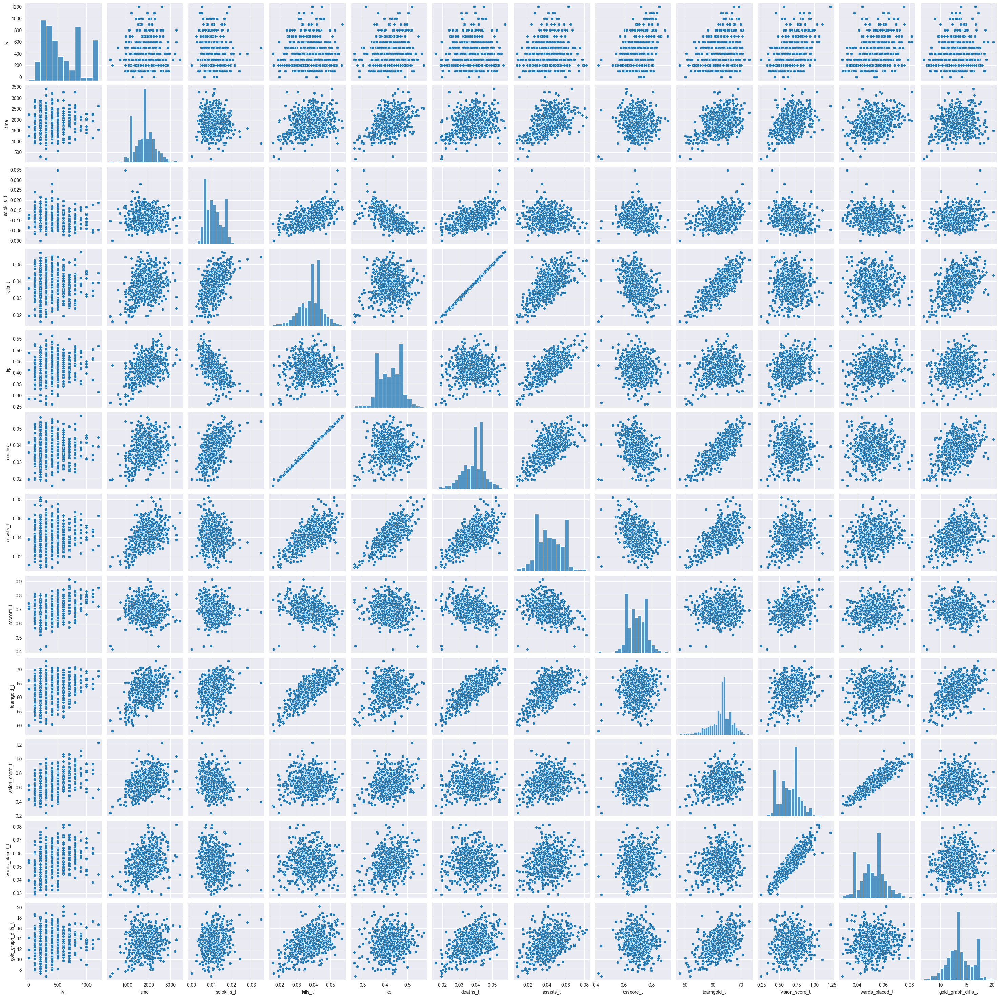

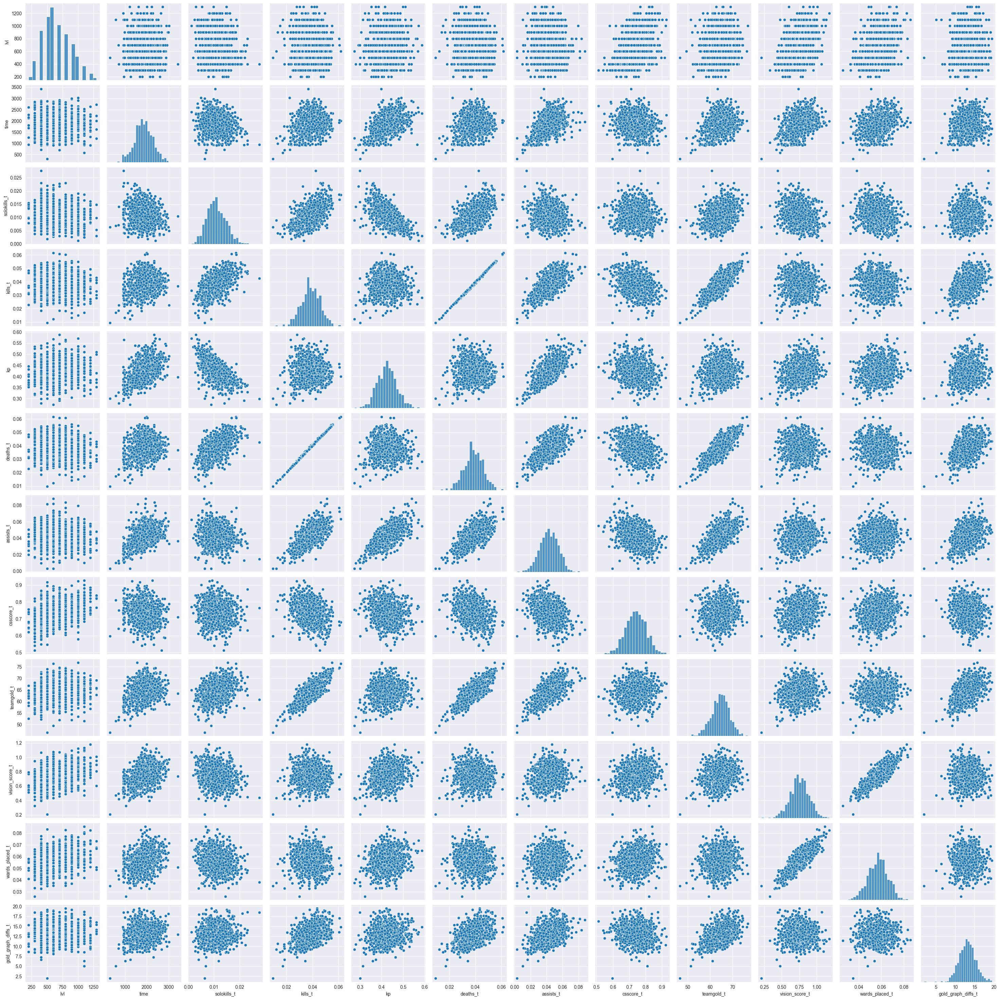

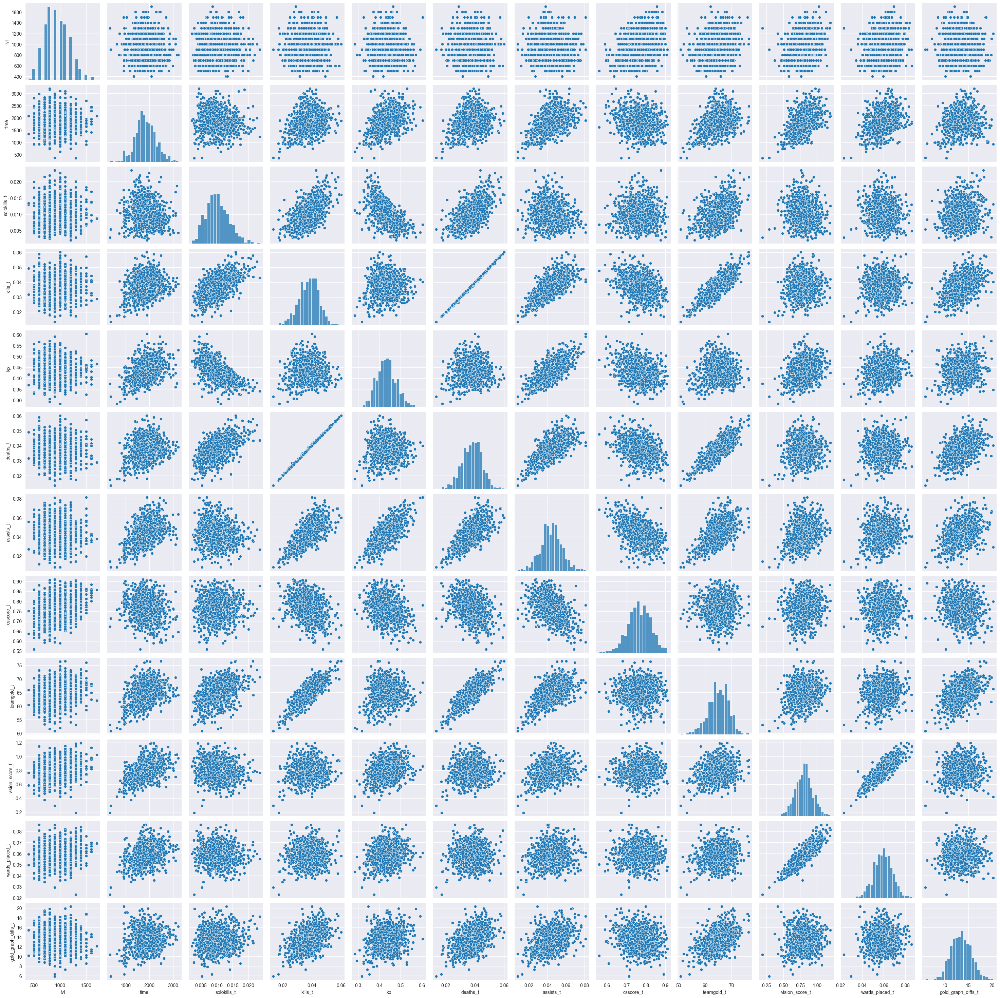

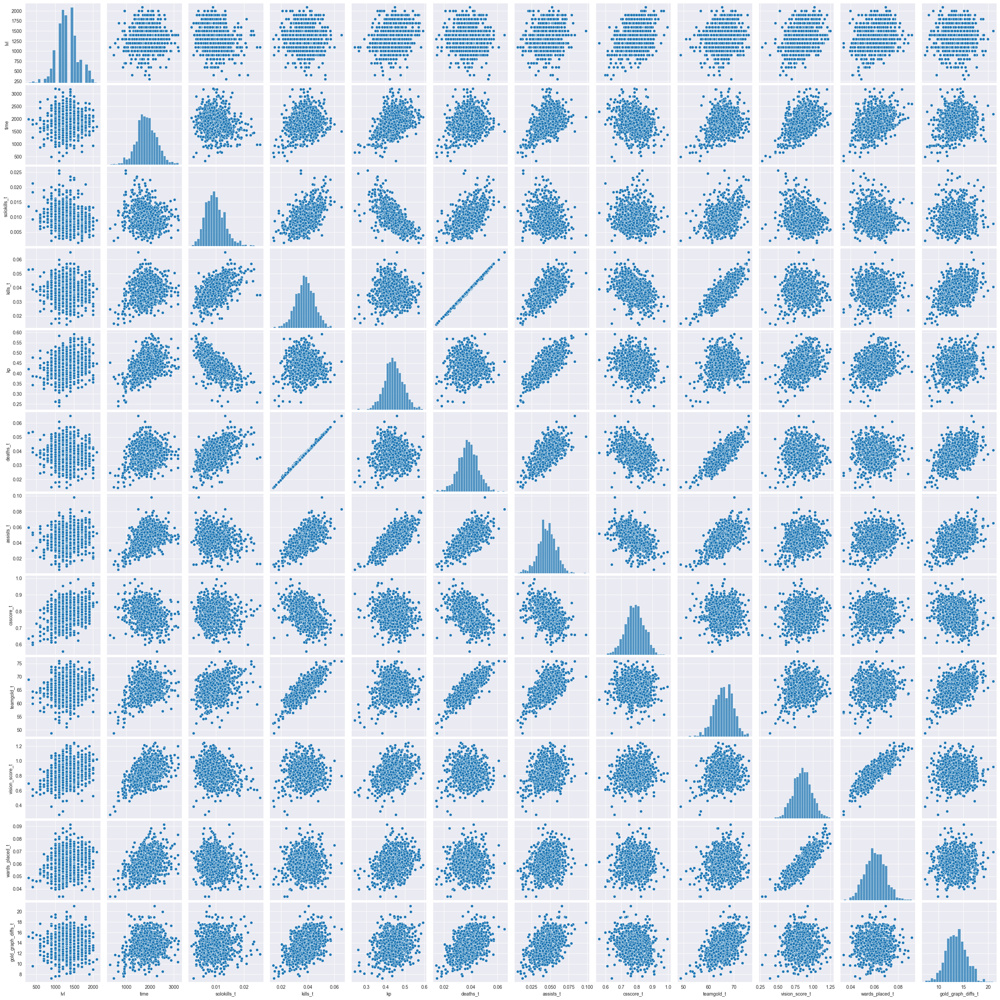

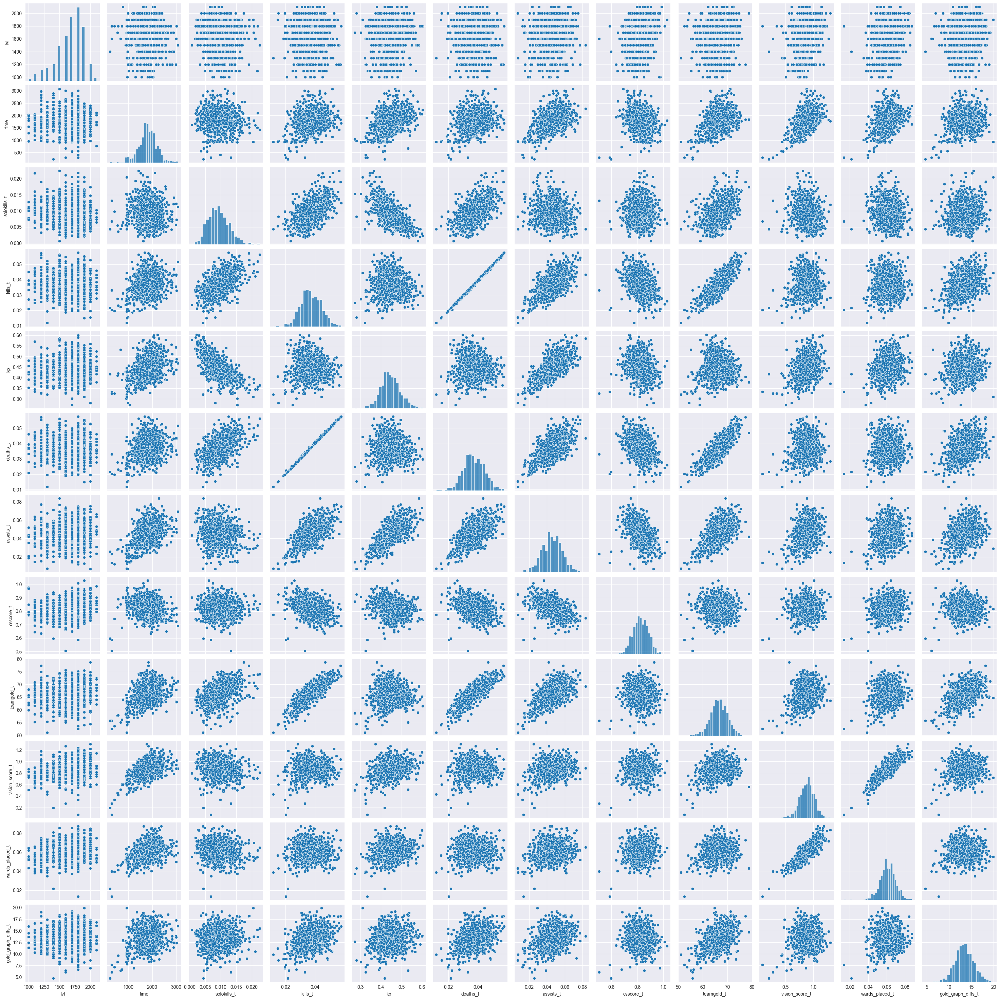

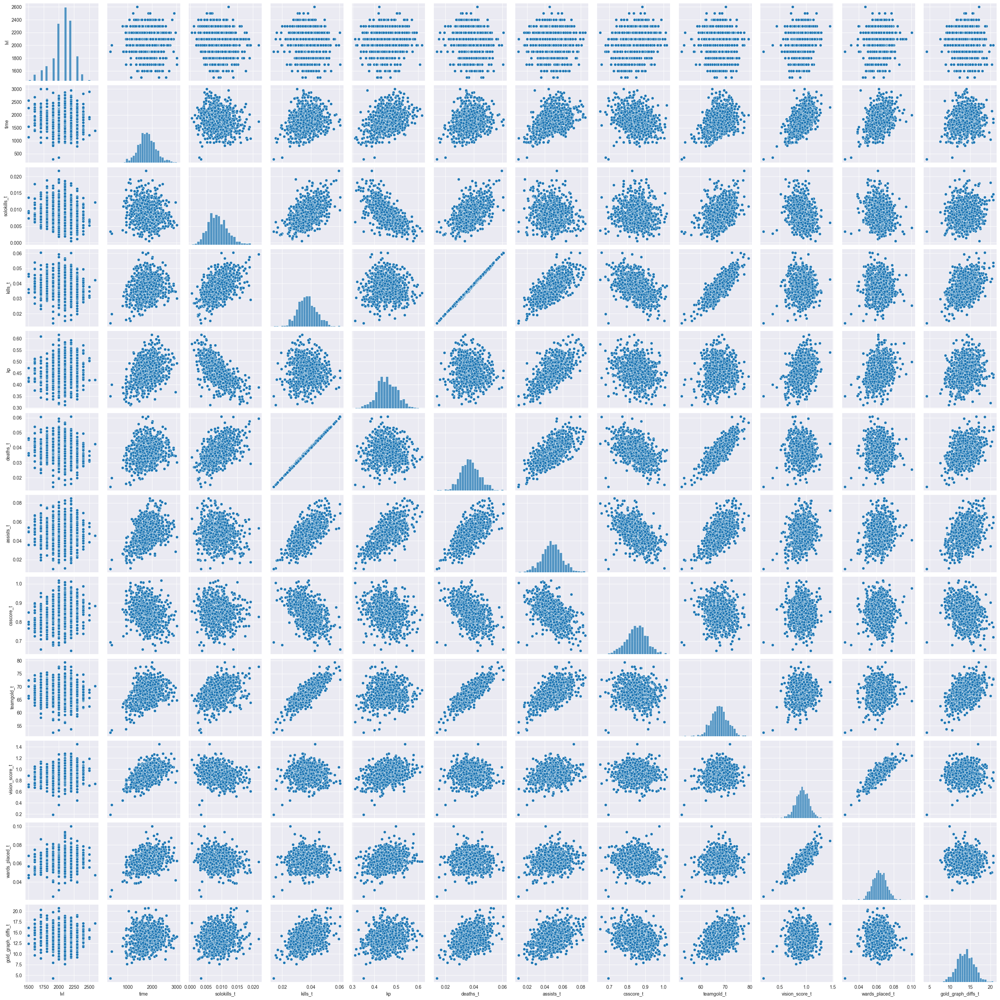

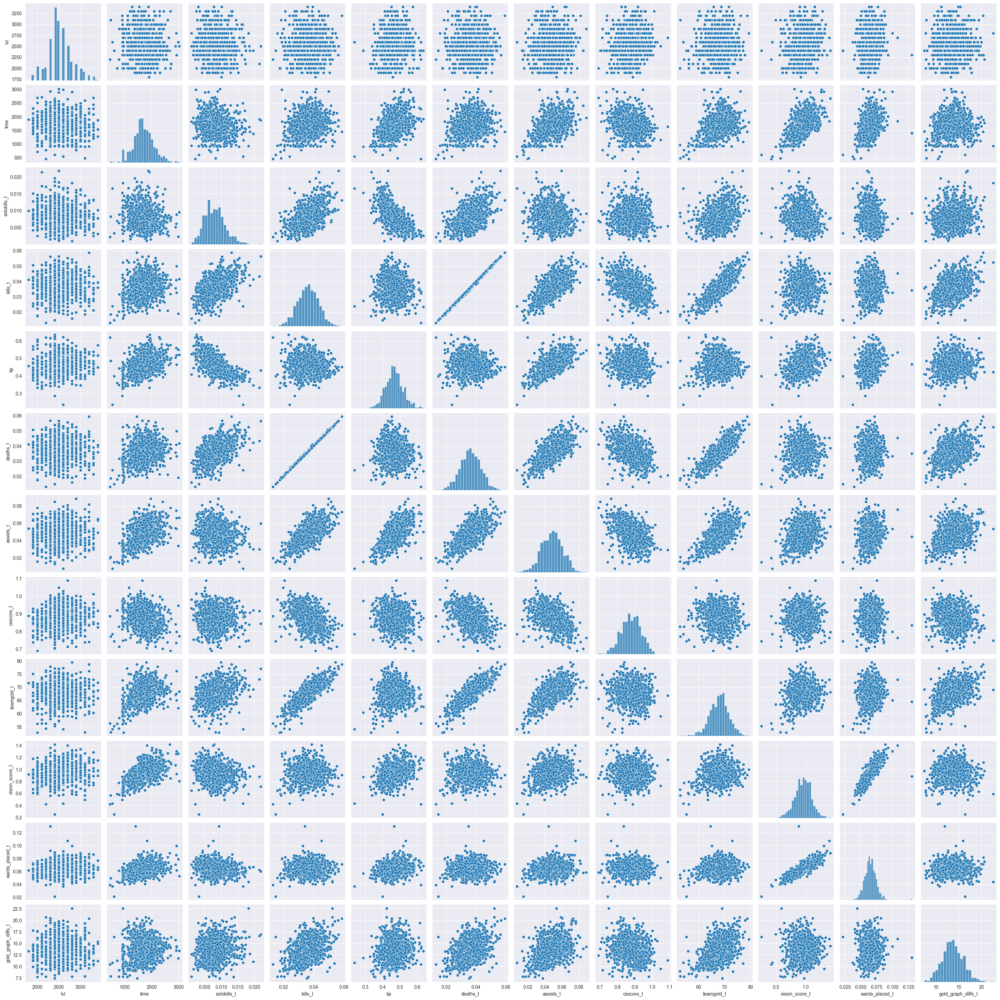

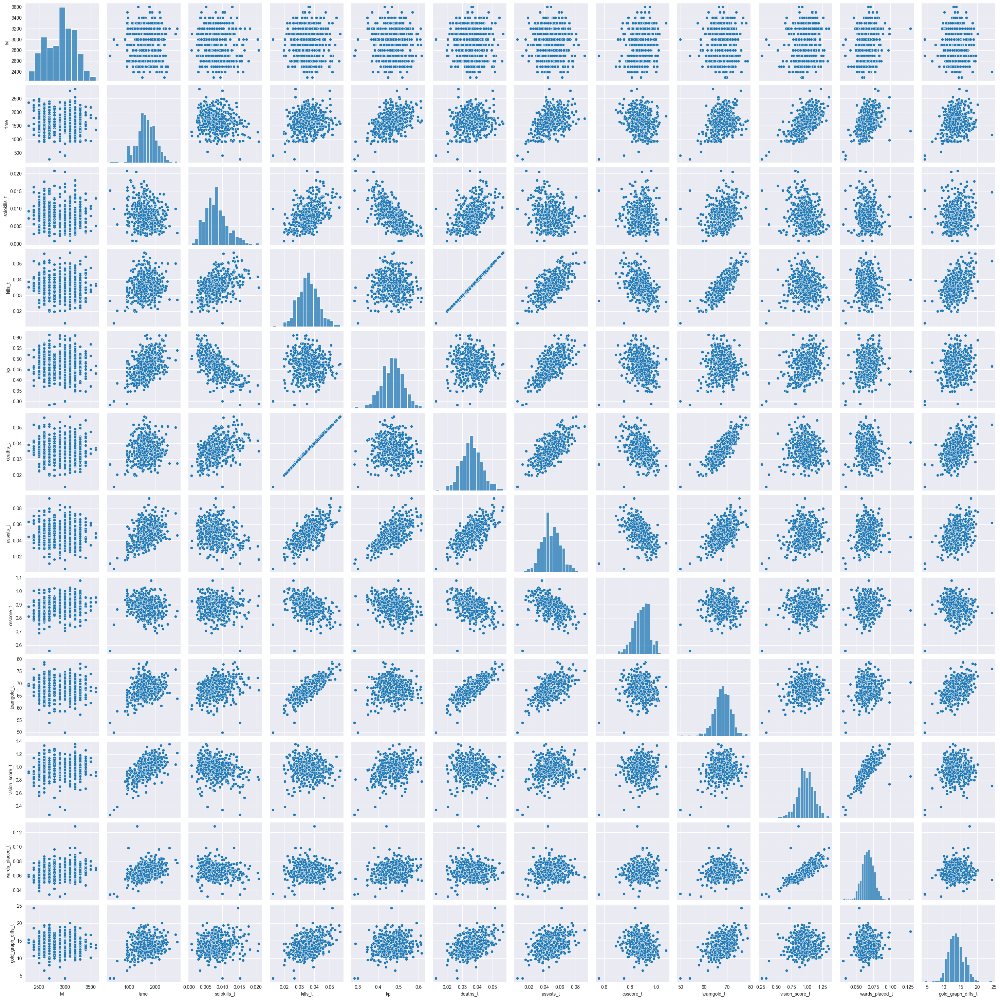

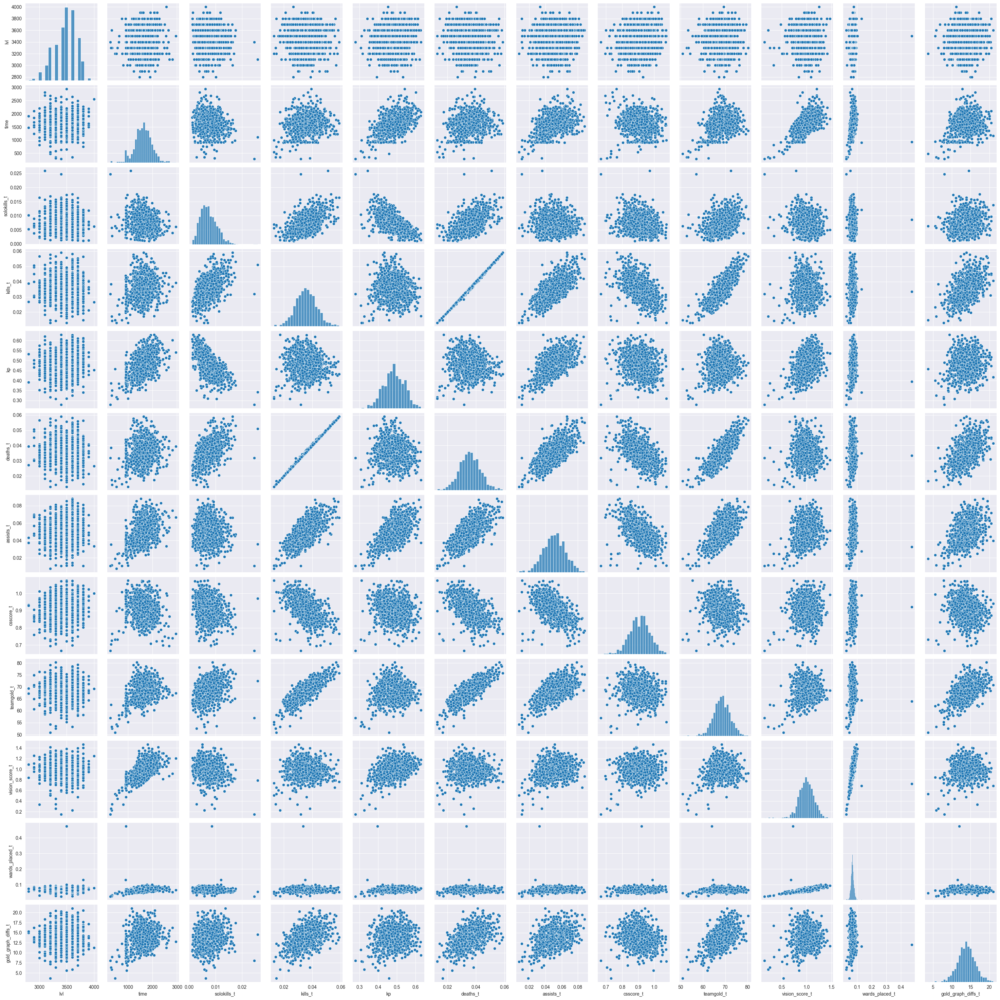

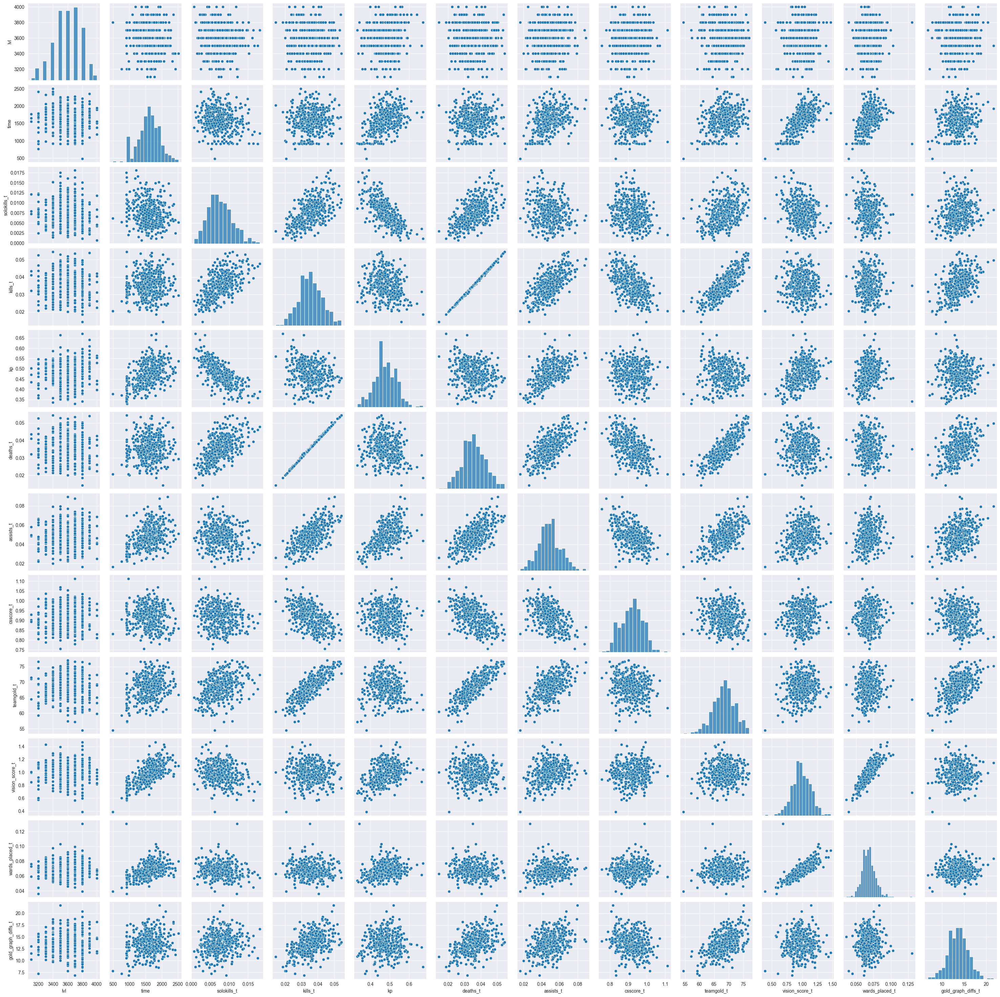

In [37]:


for df,rank in zip(df_per_rank_list,constants.SUMMONERS_TO_CHECK.keys()):
    g = sns.pairplot(df)

    g.savefig(f"Graphs/PairGrids/{rank}.png")


# Kills_t and deaths_t are essencially the same feature, so we'll erase one of them. #

Merge all dataframes into one, and drop deaths_t column.

In [5]:
df = model_training.make_big_df(df_per_rank_list)


In [6]:
df.head()

,id,lvl,literal level,time,solokills_t,kills_t,kp,deaths_t,assists_t,csscore_t,teamgold_t,vision_score_t,wards_placed_t,gold_graph_diffs_t
0,EUN1_3553719203,700,BRONZE I,1823,0.005485,0.043884,0.440727,0.043884,0.054855,0.815688,67.945145,0.745243,0.054855,15.892485
1,EUN1_3440378740,800,SILVER IV,1872,0.006944,0.043269,0.477195,0.043803,0.059829,0.622329,64.412927,0.749740,0.057692,13.800748
2,EUN1_3407962800,800,SILVER IV,2545,0.011395,0.044008,0.455357,0.044401,0.056189,0.711591,67.499411,0.865436,0.067583,13.827112
3,EUN1_3565295000,400,BRONZE IV,1206,0.010779,0.024046,0.344156,0.024046,0.017413,0.794362,55.200663,0.618011,0.051410,8.286899
4,EUN1_3576638017,100,IRON III,2132,0.015478,0.042683,0.391256,0.042683,0.040807,0.616792,62.218574,0.845845,0.066604,16.370544


For regression, we won't need id and literal level column.

In [7]:
columns_to_drop = ['id','literal level','deaths_t']
df = df.drop(columns=columns_to_drop)

In [8]:
df.head()

,lvl,time,solokills_t,kills_t,kp,assists_t,csscore_t,teamgold_t,vision_score_t,wards_placed_t,gold_graph_diffs_t
0,700,1823,0.005485,0.043884,0.440727,0.054855,0.815688,67.945145,0.745243,0.054855,15.892485
1,800,1872,0.006944,0.043269,0.477195,0.059829,0.622329,64.412927,0.749740,0.057692,13.800748
2,800,2545,0.011395,0.044008,0.455357,0.056189,0.711591,67.499411,0.865436,0.067583,13.827112
3,400,1206,0.010779,0.024046,0.344156,0.017413,0.794362,55.200663,0.618011,0.051410,8.286899
4,100,2132,0.015478,0.042683,0.391256,0.040807,0.616792,62.218574,0.845845,0.066604,16.370544


Determining target and features

In [9]:
y = df['lvl']
X = df.drop(columns=['lvl'])

Train test split and normalize

In [10]:
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(X)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33,
                                                        random_state=42)

Used regressors

In [11]:
regressors = {
        "Linear Regression": LinearRegression(),
        "Decision Tree": DecisionTreeRegressor(),
        "Random Forest": RandomForestRegressor(),
        "Support Vector Machine": SVR(),
        "K-Nearest Neighbors": KNeighborsRegressor()
    }

# Start off with  LinearReggresion #

In [12]:
lr_model = regressors['Linear Regression']
lr_model.fit(X_train,y_train)
lr_pred = lr_model.predict(X_test)
rmse_lr = np.sqrt(mean_squared_error(y_test,lr_pred))
print(f'Linear Model Params: {np.round(lr_model.coef_,5)}, {np.round(lr_model.intercept_,5)}')
print(f'Root Square Mean Error: {rmse_lr}')

Linear Model Params: [-7.36320000e-01  2.69981180e+04 -3.57600794e+04 -4.39364490e+02
  3.88389477e+04  6.27761180e+03  2.05287400e+01  1.53798588e+03
 -2.31044717e+03  4.91649000e+00], -5152.9519
Root Square Mean Error: 547.2409281061186


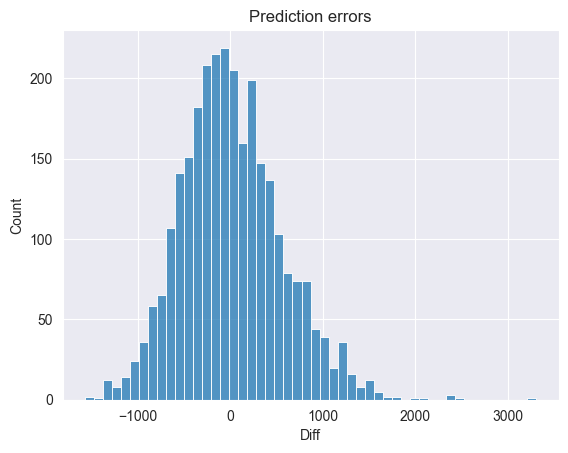

In [13]:
visualize_errors(y_test,lr_pred)

# Polynomial Regression #

In [ ]:
model = make_pipeline(PolynomialFeatures(), LinearRegression())

# Define the parameter grid for GridSearchCV
param_grid = {
    'polynomialfeatures__degree': np.arange(1, 10),
}

# Perform grid search with cross-validation
grid_search = GridSearchCV(model, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

# Get the best degree of polynomial
best_degree = grid_search.best_params_['polynomialfeatures__degree']

# Train the model with the best degree of polynomial
best_model = make_pipeline(PolynomialFeatures(degree=best_degree), LinearRegression())

# Random Forest Regressor #

In [40]:
rf_regressor = RandomForestRegressor()
param_grid = {
    'n_estimators': [10,20,30,40,50,100,200],
    'max_depth': [None, 5, 10,],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=rf_regressor, param_grid=param_grid, cv=5,n_jobs=8,verbose=3)
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_

print("Best parameters:", best_params)
rf_regressor_best = grid_search.best_estimator_

Fitting 5 folds for each of 189 candidates, totalling 945 fits
[CV 2/5] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.711 total time=   0.4s
[CV 5/5] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.703 total time=   0.7s
[CV 2/5] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=40;, score=0.736 total time=   1.5s
[CV 5/5] END max_depth=None, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=0.708 total time=   1.5s
[CV 2/5] END max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=40;, score=0.738 total time=   1.2s
[CV 4/5] END max_depth=None, min_samples_leaf=1, min_samples_split=5, n_estimators=50;, score=0.749 total time=   1.6s
[CV 5/5] END max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=30;, score=0.708 total time=   1.0s
[CV 2/5] END max_depth=None, min_samples_leaf=1, min_samples_split=10, n_estimators=50;, score=0.741 to

# SVR #

In [42]:
svr = SVR()

# Parameter grid for grid search
param_grid = {
    'kernel': ['rbf', 'linear'],  # Kernel type
    'C': [0.1, 1, 70,80,90, 100,],        # Regularization parameter
    'gamma': [0.01, 0.1, 1, 10],   # Kernel coefficient (for rbf kernel)
    'epsilon': [0.01, 0.1, 1]      # Epsilon in the epsilon-SVR model
}

grid_search = GridSearchCV(estimator=svr, param_grid=param_grid, cv=5,n_jobs=8,verbose=3)
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_
print("Best parameters:", best_params)

svr_best = grid_search.best_estimator_

Fitting 5 folds for each of 144 candidates, totalling 720 fits


KeyboardInterrupt: 